## EPA Sensor Location
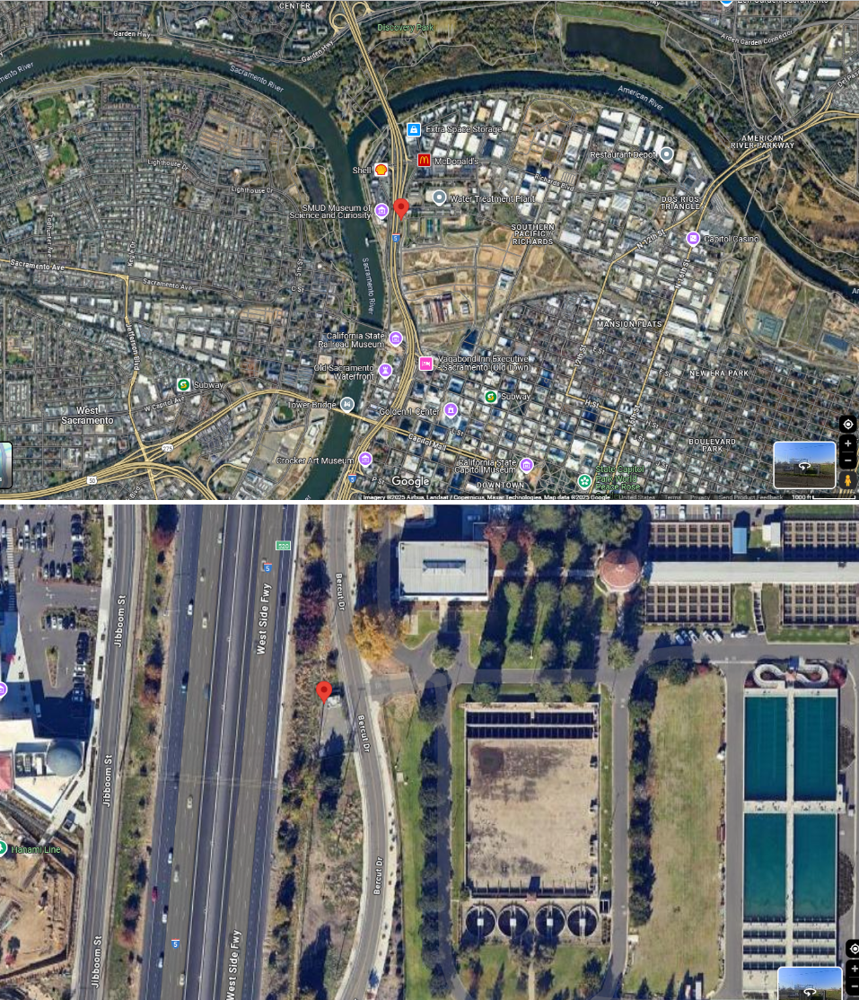


### These plots will compare various Planetary Boundary Layer (PBL) Models to the baseline model of MYJ (which is picked with bl_pbl_physics = -1, which is actually set with value 2).

### Let's compare to bl_pbl_physics = 1, YSU Model first

### Let's plot the difference in the variable with various PBL Models MYJ (bl_pbl_physics=2 or -1), YSU (pbl = 1)

718


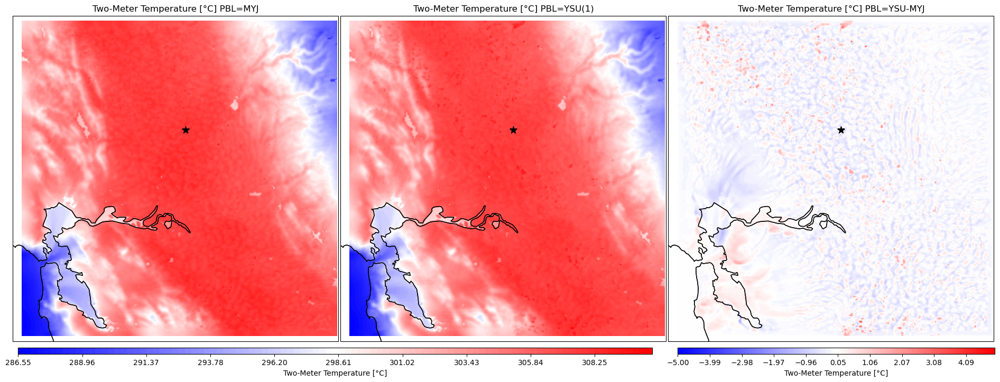

In [1]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob

## Load the Input Files
ncfile0 = Dataset("/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_MP8_RAD4_250710/wrfout_d01_2020-06-30_21:00:00")
ncfile1 = Dataset("/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_MP8_RAD4_250711/wrfout_d01_2020-06-30_21:00:00")
#ncfile2 = Dataset("/data/wto/WRF/WRFV4.5/test/em_real_PBL5/wrfout_d01_2020-06-23_21:00:00")
EPAVar = (np.loadtxt("/data/wto/EPAMetData/hourly_TEMP_2020_06_Sac.csv", delimiter=',',usecols=[13])-32)*5/9
print(len(EPAVar))

## User Parameters
### Set the Variable you want to look at. ####
Var = "T2"
VarLabel = "Two-Meter Temperature [°C]"

### Grab the Variables, long, lats and projections.
Var0 = getvar(ncfile0, Var)
wrf_proj = get_cartopy(Var0)
lats, lons = latlon_coords(Var0)
#Var0=Var0-273.15
Var1 = getvar(ncfile1, Var)
#Var1=Var1-273.15

# Create figure with minimal whitespace
fig, (ax0, ax1, ax2) = plt.subplots(1, 3, subplot_kw={'projection': wrf_proj}, 
                               gridspec_kw={'wspace': -0.0}, figsize=(24, 8))

# Add shared colorbar spanning only the width of both plots
levels = np.linspace(np.min([to_np(Var0).min(),to_np(Var1).min()]),
                     np.max([to_np(Var0).max(),to_np(Var1).max()]), 100)

#  contour plot for UCM=0
ax0.set_title(VarLabel+ " PBL=MYJ")
ax0.set_extent([to_np(lons).min(), to_np(lons).max(), to_np(lats).min(), to_np(lats).max()], crs=cp.crs.PlateCarree())
center_lon, center_lat = -121.49, 38.58
lon_min, lon_max = center_lon - 0.3, center_lon + 0.3
lat_min, lat_max = center_lat - 0.25, center_lat + 0.25
#ax0.set_extent([lon_min, lon_max, lat_min, lat_max], crs=cp.crs.PlateCarree())
contour0 = ax0.contourf(to_np(lons), to_np(lats),to_np(Var0),transform=cp.crs.PlateCarree(), cmap="bwr",levels=levels) 
# Add geographical features and a star marker for Sacramento
ax0.add_feature(cp.feature.COASTLINE)
ax0.add_feature(cp.feature.STATES)
ax0.scatter(-121.49, 38.58, color='black', marker='*', s=100, label="Sacramento",transform=cp.crs.PlateCarree())


#  contour plot for UCM=1 
ax1.set_title(VarLabel+ " PBL=YSU(1)")
ax1.set_extent([to_np(lons).min(), to_np(lons).max(), to_np(lats).min(), to_np(lats).max()], crs=cp.crs.PlateCarree())
#ax1.set_extent([lon_min, lon_max, lat_min, lat_max], crs=cp.crs.PlateCarree())
contour1 = ax1.contourf(to_np(lons), to_np(lats), to_np(Var1),transform=cp.crs.PlateCarree(), cmap="bwr",levels=levels) 
# Add geographical features and a star marker for Sacramento
ax1.add_feature(cp.feature.COASTLINE)
ax1.add_feature(cp.feature.STATES)
ax1.scatter(-121.49, 38.58, color='black', marker='*', s=100, label="Sacramento",transform=cp.crs.PlateCarree())

cbar_ax1 = fig.add_axes([0.13, 0.08, 0.5, 0.015])  # [left, bottom, width, height]
cbar1 = fig.colorbar(contour0, cax=cbar_ax1, orientation="horizontal")
cbar1.set_label(VarLabel)

#  contour plot for UCM= (1-0)
ax2.set_title(VarLabel+ " PBL=YSU-MYJ")
ax2.set_extent([to_np(lons).min(), to_np(lons).max(), to_np(lats).min(), to_np(lats).max()], crs=cp.crs.PlateCarree())
contour2 = ax2.contourf(to_np(lons), to_np(lats), to_np(Var1)-to_np(Var0),transform=cp.crs.PlateCarree(), cmap="bwr",levels=np.linspace(-5,5,100)) 
# Add geographical features and a star marker for Sacramento
ax2.add_feature(cp.feature.COASTLINE)
ax2.add_feature(cp.feature.STATES)
ax2.scatter(-121.49, 38.58, color='black', marker='*', s=100, label="Sacramento",transform=cp.crs.PlateCarree())
# Add shared colorbar spanning only the width of both plots
cbar_ax2 = fig.add_axes([0.65, 0.08, 0.25, 0.015])  # [left, bottom, width, height]
cbar2 = fig.colorbar(contour2, cax=cbar_ax2, orientation="horizontal")
cbar2.set_label(VarLabel)

plt.show()

### Compare the Models to EPA Data in Sacramento.

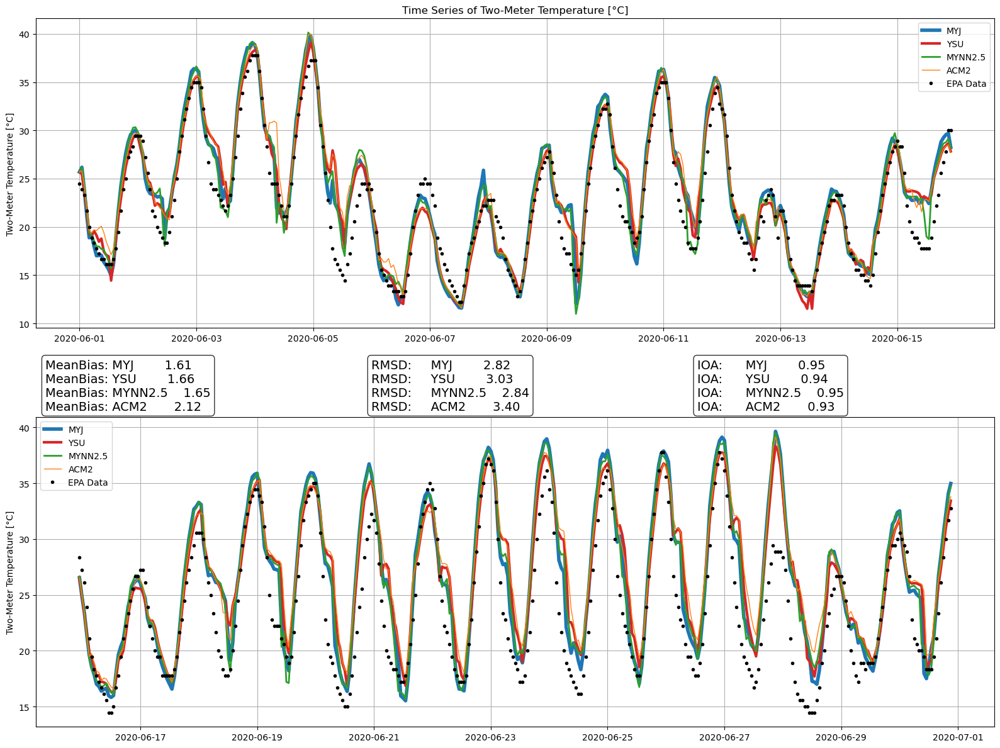

[[1.61389253475247, 1.6610000293936171, 1.652268601762611, 2.115293283087689], [2.82019858828357, 3.0325156700088396, 2.843353387059184, 3.39593844765865], [0.9522160294255846, 0.941085611682689, 0.951116509279052, 0.9265178376013244]]


In [3]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "T2"
Title = "Time Series of Two-Meter Temperature [°C]"
YLabel = "Two-Meter Temperature [°C]"
lat_point = 37.689
lon_point = -121.4415
## Load the EPA Data Input File
DataVal = (np.loadtxt("/data/wto/EPAMetData/hourly_TEMP_2020_06_Sac.csv", delimiter=',',usecols=[13])-32)*5/9
#print(len(DataVal))

# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point, offset=-273.15)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

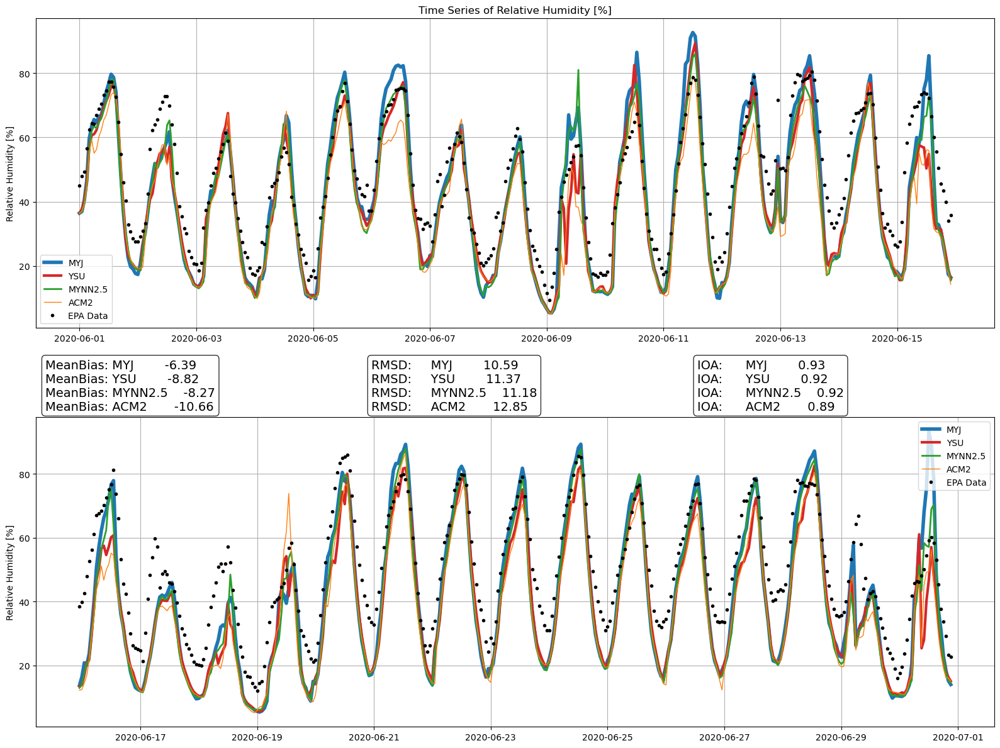

[[-6.392405367296053, -8.8176049171384, -8.268562664361387, -10.662867828464774], [10.58505900145926, 11.365931212792722, 11.182753131337925, 12.84611666224657], [0.9338746410334042, 0.9162243946625258, 0.9232426442835903, 0.8921823873019941]]


In [4]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "rh2"
Title = "Time Series of Relative Humidity [%]"
YLabel = "Relative Humidity [%]"
lat_point = 38.56844
lon_point = -121.49311
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_RH_DP_2020_06_Sac.csv", delimiter=',',usecols=[13],max_rows=718)
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

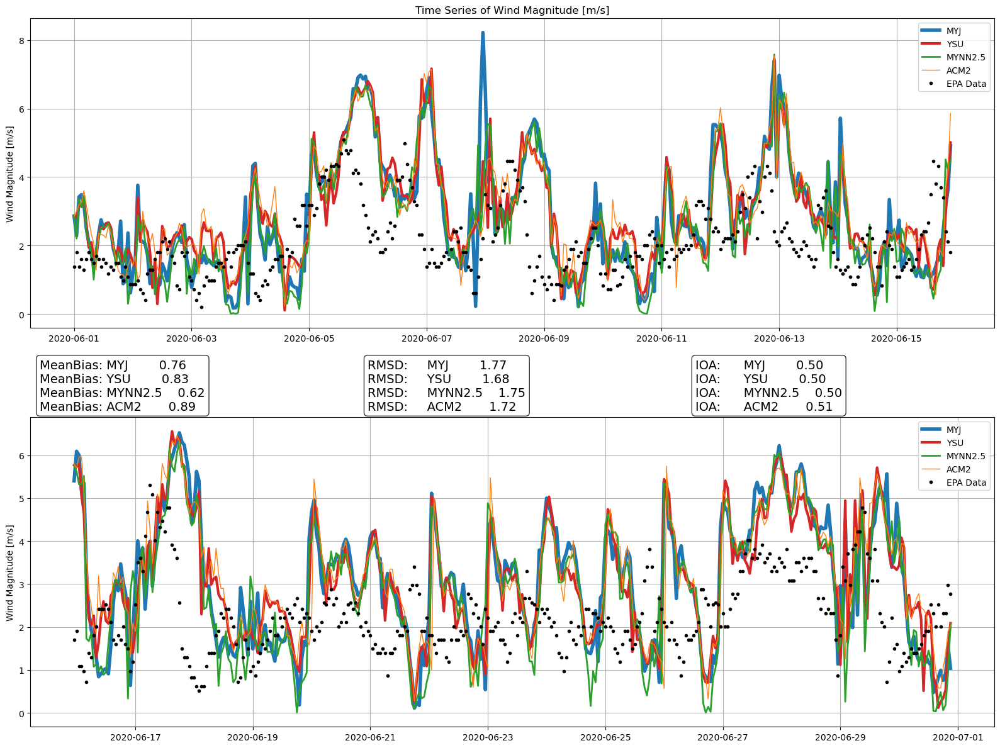

[[0.760965278312253, 0.8272854289255397, 0.6154472578365028, 0.8940504746571354], [1.7724817532651285, 1.6807496705588494, 1.7492656508110358, 1.7168870929632165], [0.5016502292475133, 0.49931779857194614, 0.49541491321677544, 0.5061614543359749]]


In [5]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "wspd10"
Title = "Time Series of Wind Magnitude [m/s]"
YLabel = "Wind Magnitude [m/s]"
lat_point = 38.593322
lon_point = -121.503795
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_WINDMAG_2020_06_Sac.csv", delimiter=',',usecols=[13],max_rows=718)*0.514444
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

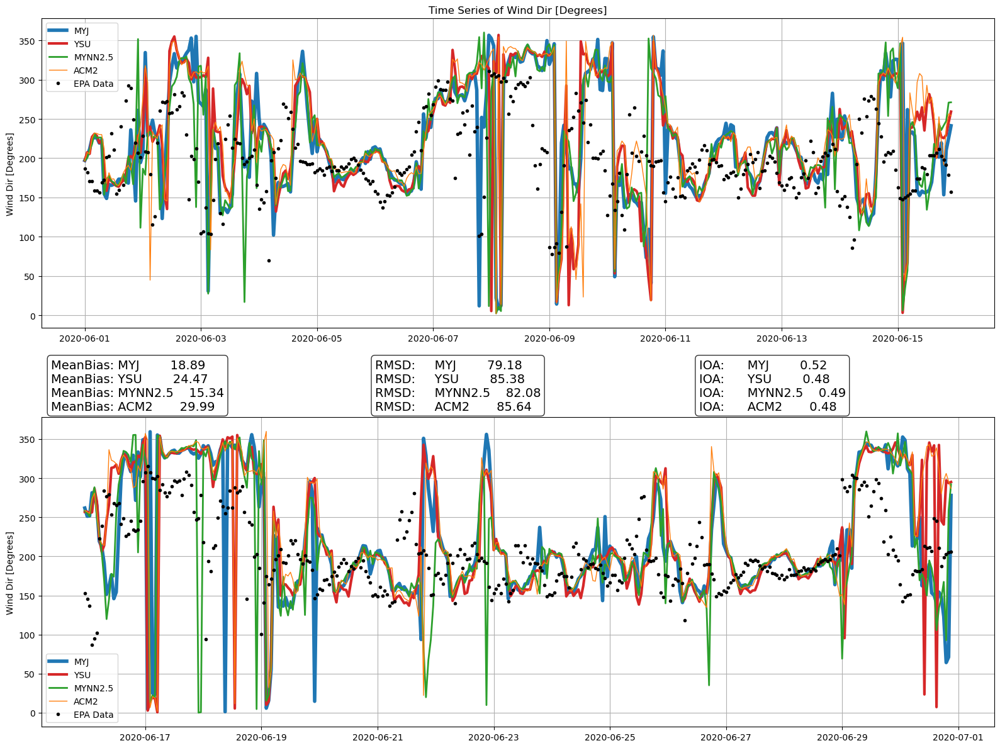

[[18.89467534447779, 24.47109572726372, 15.336543437887325, 29.992145159450413], [79.18477573775834, 85.37592144638428, 82.0846012744033, 85.64241511388202], [0.5186539040333247, 0.4810517704311653, 0.49327959615961403, 0.4811596005613381]]


In [6]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "wdir10"
Title = "Time Series of Wind Dir [Degrees]"
YLabel = "Wind Dir [Degrees]"
lat_point = 38.593322
lon_point = -121.503795
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_WINDDIR_2020_06_Sac.csv", delimiter=',',usecols=[13],max_rows=718)
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

### Lets look at another location.
Lat,Long = 38.302591,-121.420838<br>
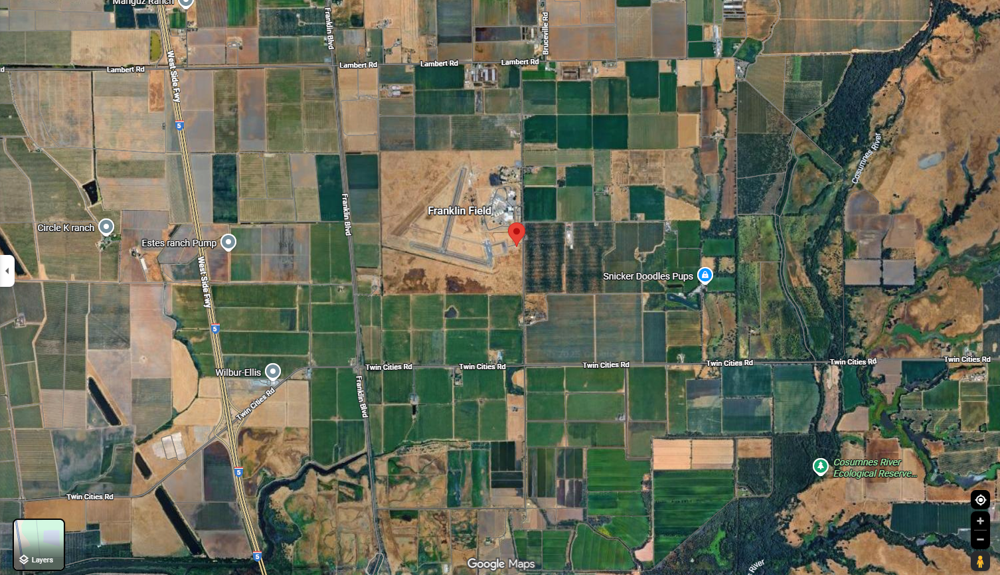

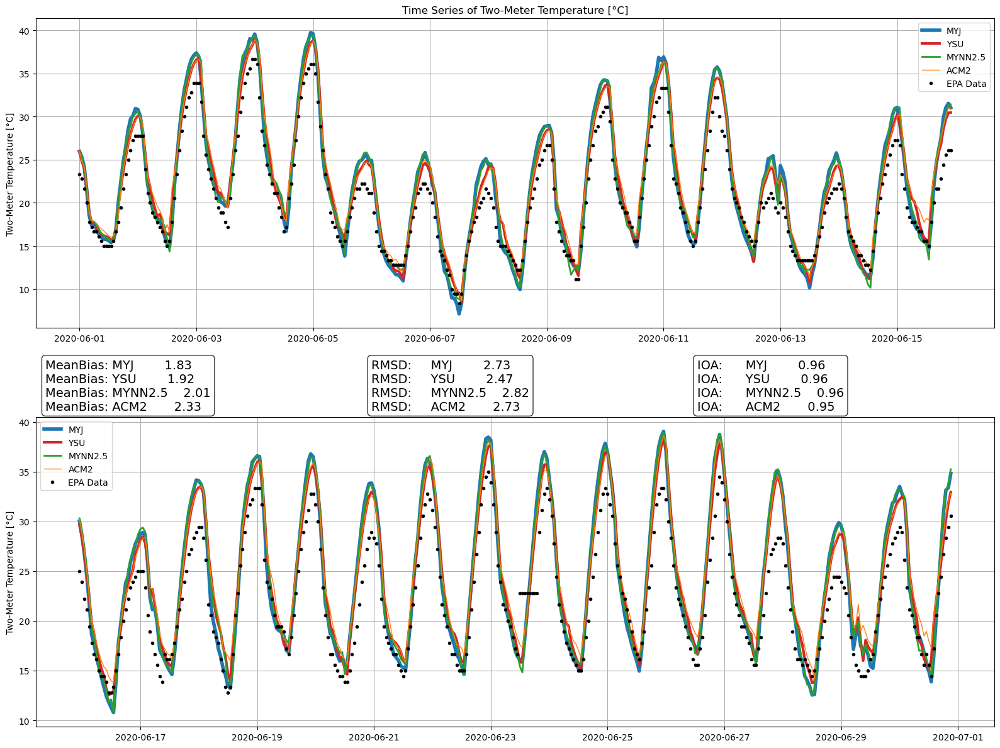

[[1.8250978498774917, 1.9157739051906446, 2.01395503203224, 2.328718093215649], [2.734104924630463, 2.47194555281789, 2.815225668972841, 2.7304244204495256], [0.9592685155737479, 0.9637928608122268, 0.9562054282923208, 0.9547868966680171]]


In [10]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "T2"
Title = "Time Series of Two-Meter Temperature [°C]"
YLabel = "Two-Meter Temperature [°C]"
lat_point = 38.302591
lon_point = -121.420838
## Load the EPA Data Input File
DataVal = (np.loadtxt("/data/wto/EPAMetData/hourly_TEMP_2020_06_Franklin.csv", delimiter=',',usecols=[13],max_rows=718)-32)*5/9
#print(len(DataVal))

# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point, offset=-273.15)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

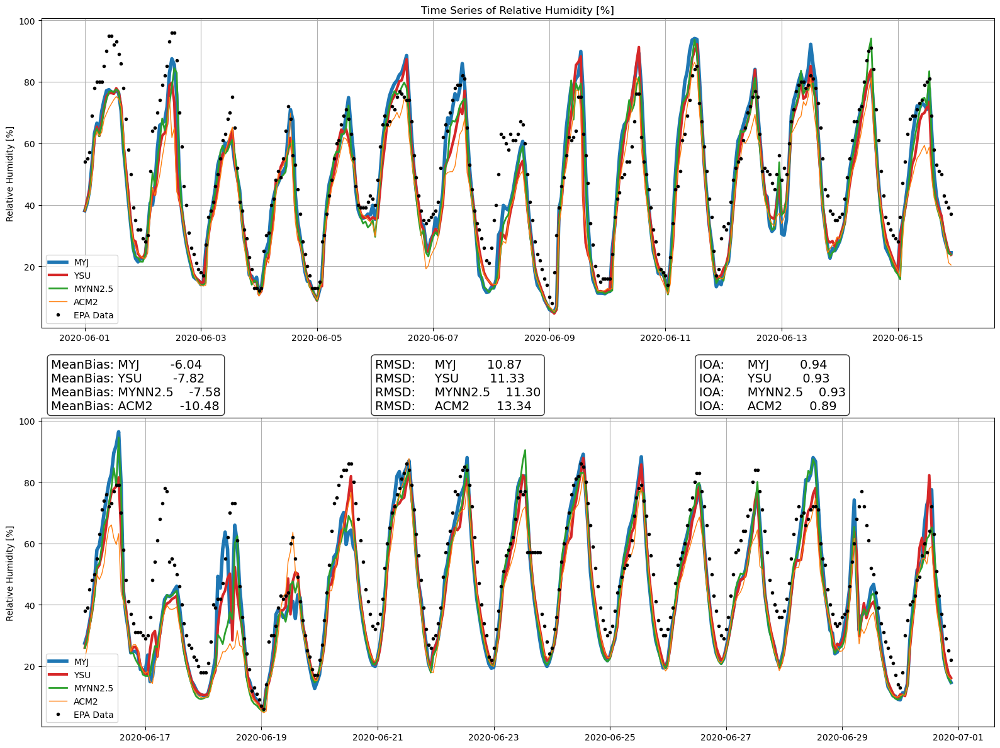

[[-6.040495130677077, -7.823700754091268, -7.577598336679357, -10.481612679021936], [10.867465392762558, 11.334064172004897, 11.298529128408283, 13.342644882844603], [0.935586781069937, 0.9255025004576846, 0.9291734223416492, 0.8939972780659262]]


In [11]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "rh2"
Title = "Time Series of Relative Humidity [%]"
YLabel = "Relative Humidity [%]"
lat_point = 38.302591
lon_point = -121.420838
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_RH_DP_2020_06_Franklin.csv", delimiter=',',usecols=[13],max_rows=718)
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

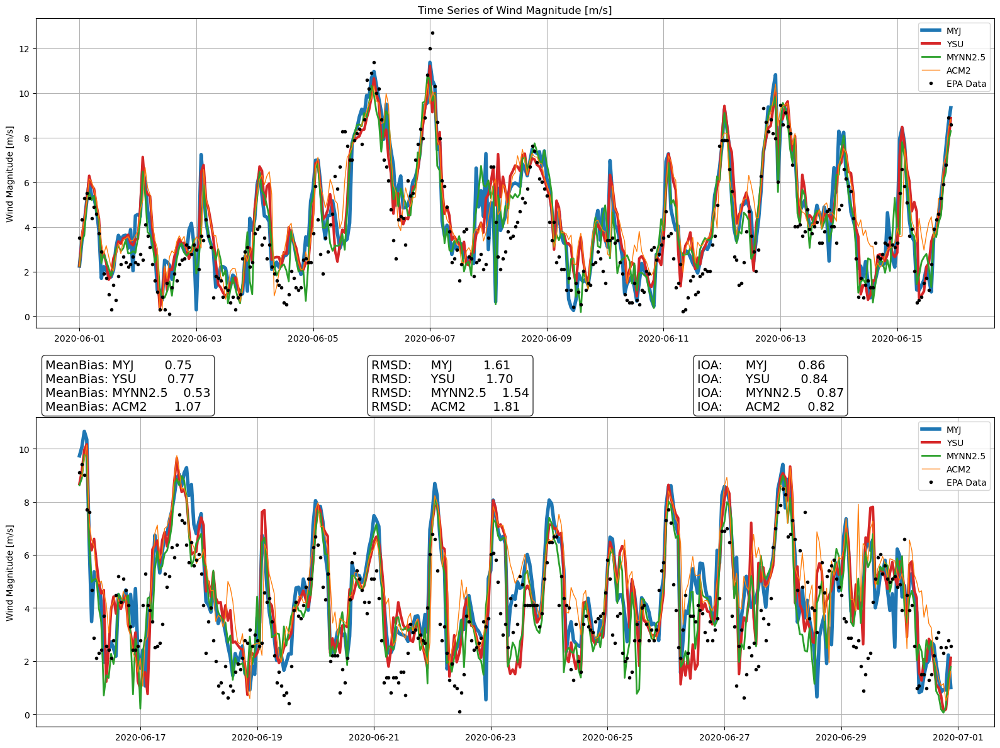

[[0.74544240676366, 0.7684263820363169, 0.5265047609235466, 1.0673840825946763], [1.6124700112232908, 1.7013995432597189, 1.5365203260476337, 1.8132568388425692], [0.8646734122484105, 0.8436918435384788, 0.8690997474539173, 0.8179744078621166]]


In [1]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "wspd10"
Title = "Time Series of Wind Magnitude [m/s]"
YLabel = "Wind Magnitude [m/s]"
lat_point = 38.302591
lon_point = -121.420838
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_WINDMAG_2020_06_Franklin.csv", delimiter=',',usecols=[13],max_rows=718)*0.514444
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

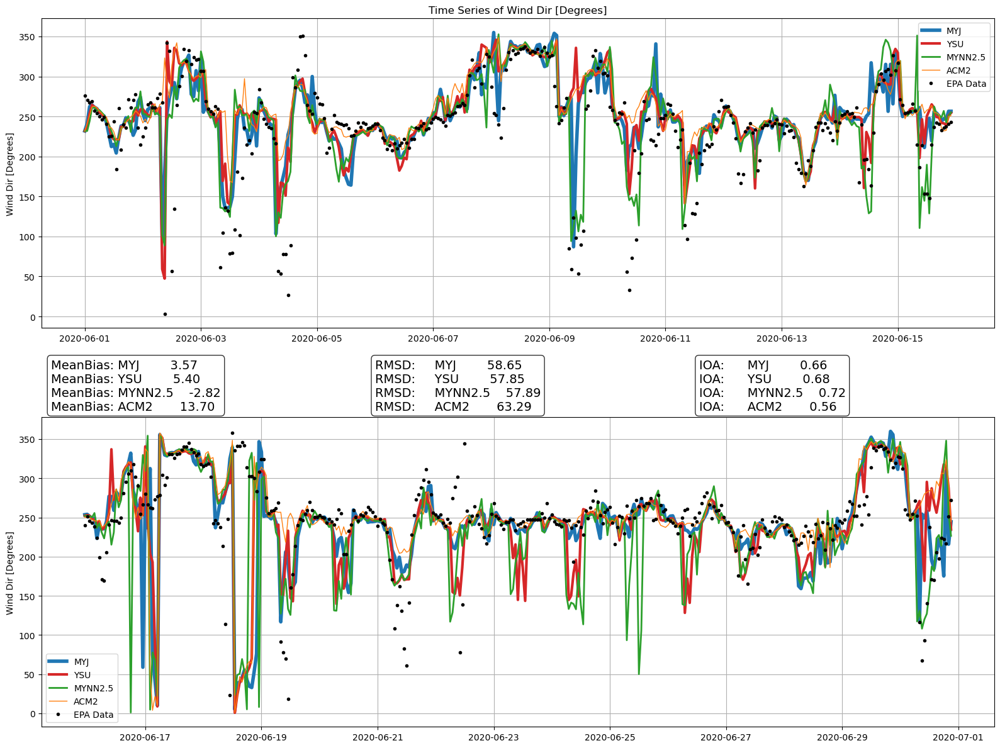

[[3.567938660778375, 5.3995488010575174, -2.8171235386707667, 13.699543143065858], [58.64652305494985, 57.85078589709473, 57.88540298812797, 63.28561385344122], [0.6576877667114378, 0.6763458150773933, 0.7242925038347188, 0.5618251157997901]]


In [13]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "wdir10"
Title = "Time Series of Wind Dir [Degrees]"
YLabel = "Wind Dir [Degrees]"
lat_point = 38.302591
lon_point = -121.420838
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_WINDDIR_2020_06_Franklin.csv", delimiter=',',usecols=[13],max_rows=718)
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

### Station Half a Mile South of the Capitol.
Lat,Long = 38.56844,-121.49311 <br>
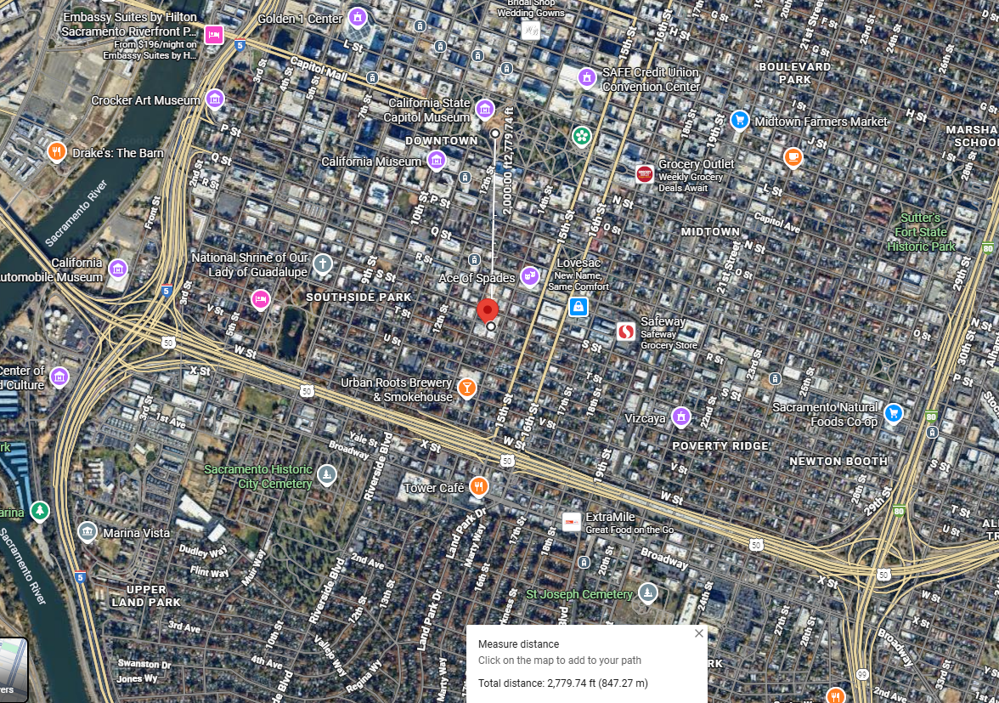

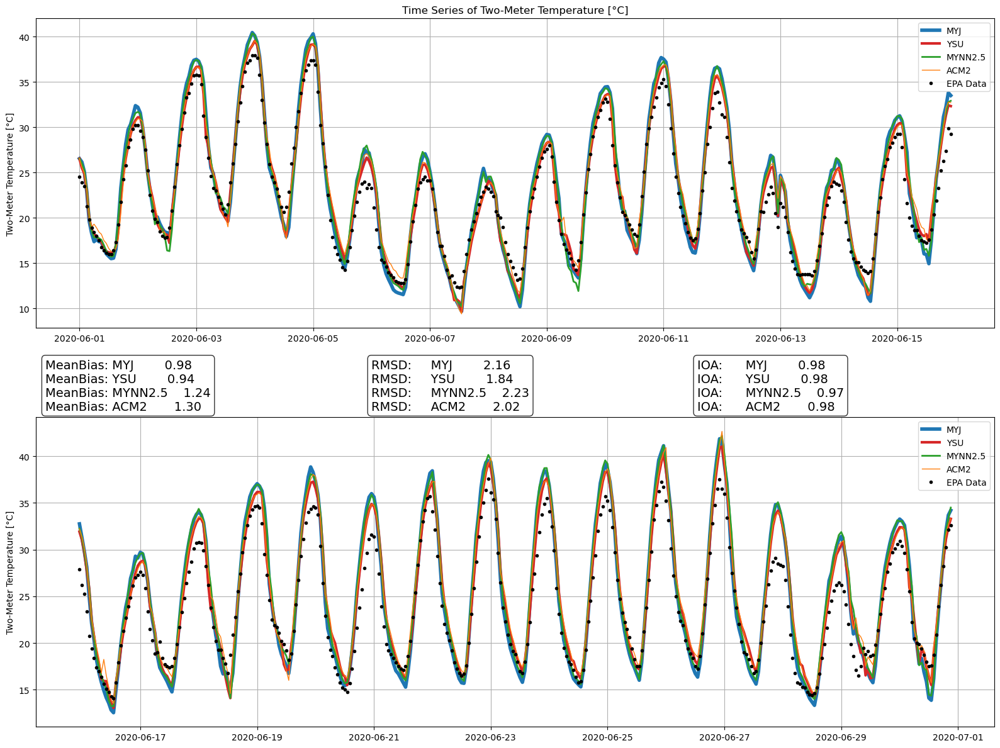

[[0.9810929322309376, 0.9446064048491044, 1.2366518918518465, 1.3033256169481426], [2.1603193841352835, 1.8400372048947533, 2.2285996715991216, 2.0169524506506957], [0.9763783305578572, 0.9813390033977962, 0.9742920030582937, 0.9773255742797696]]


In [14]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "T2"
Title = "Time Series of Two-Meter Temperature [°C]"
YLabel = "Two-Meter Temperature [°C]"
lat_point = 38.56844
lon_point = -121.49311
## Load the EPA Data Input File
DataVal = (np.loadtxt("/data/wto/EPAMetData/hourly_TEMP_2020_06_SacSoCap.csv", delimiter=',',usecols=[13],max_rows=718)-32)*5/9
#print(len(DataVal))

# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point, offset=-273.15)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

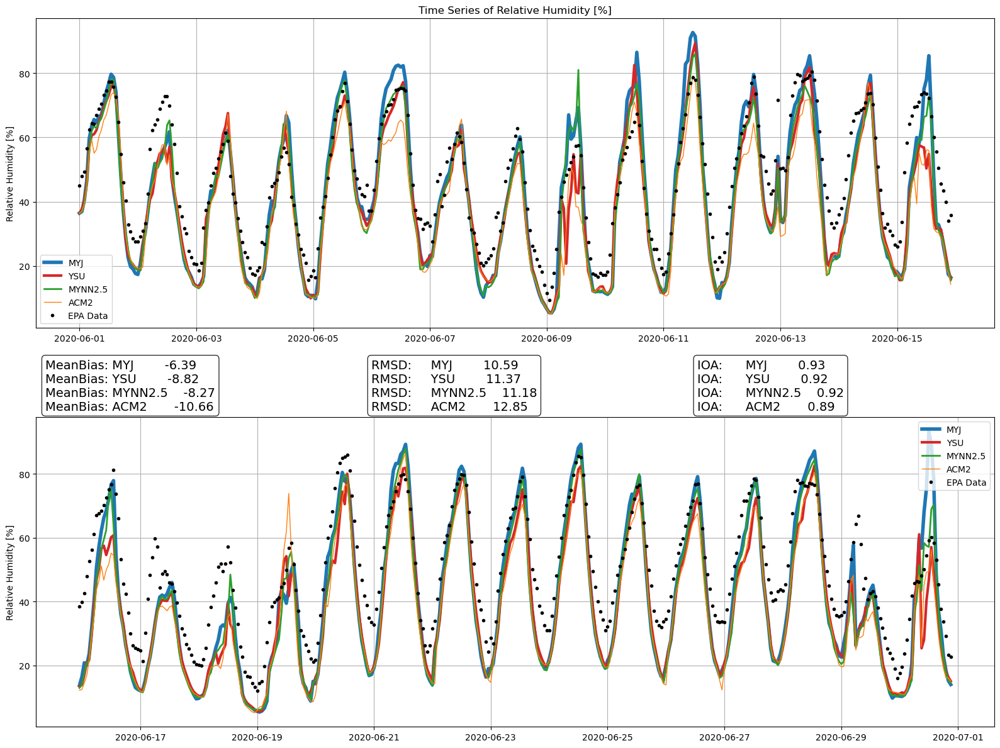

[[-6.392405367296053, -8.8176049171384, -8.268562664361387, -10.662867828464774], [10.58505900145926, 11.365931212792722, 11.182753131337925, 12.84611666224657], [0.9338746410334042, 0.9162243946625258, 0.9232426442835903, 0.8921823873019941]]


In [15]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "rh2"
Title = "Time Series of Relative Humidity [%]"
YLabel = "Relative Humidity [%]"
lat_point = 38.56844
lon_point = -121.49311
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_RH_DP_2020_06_SacSoCap.csv", delimiter=',',usecols=[13],max_rows=718)
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

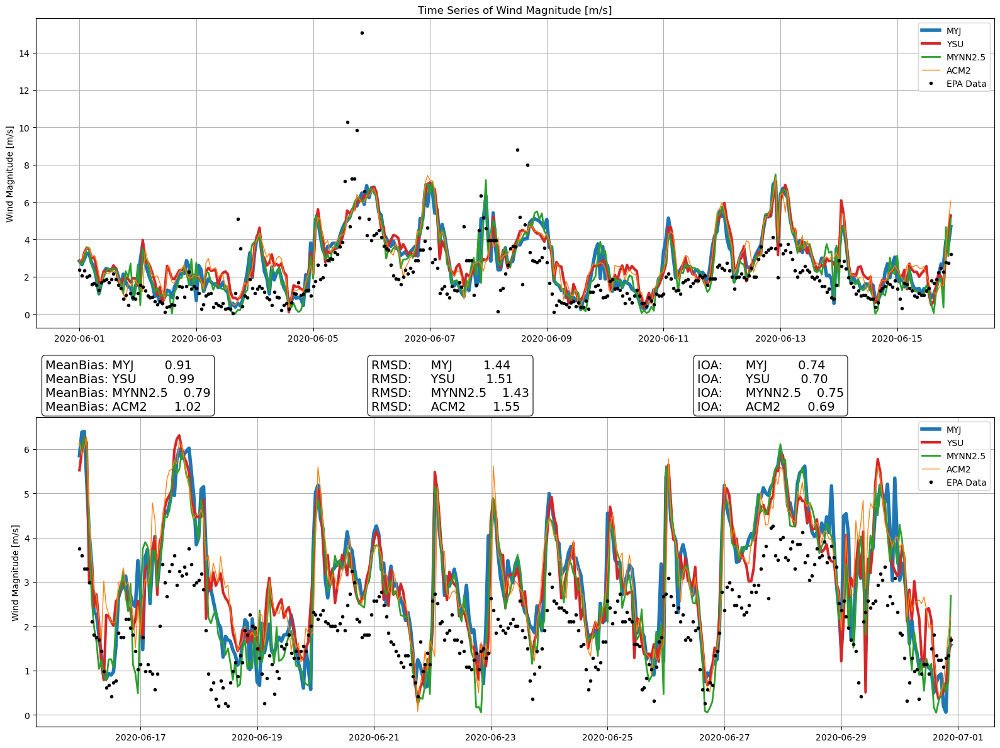

[[0.9061791548392701, 0.9880434875624394, 0.7934957400755692, 1.023022459744823], [1.438392409523395, 1.5084682219932255, 1.4321987697928444, 1.5541501210712245], [0.7445179291913715, 0.7045055927600133, 0.7494256218655202, 0.6918529683992042]]


In [16]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "wspd10"
Title = "Time Series of Wind Magnitude [m/s]"
YLabel = "Wind Magnitude [m/s]"
lat_point = 38.56844
lon_point = -121.49311
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_WINDMAG_2020_06_SacSoCap.csv", delimiter=',',usecols=[13],max_rows=718)*0.514444
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

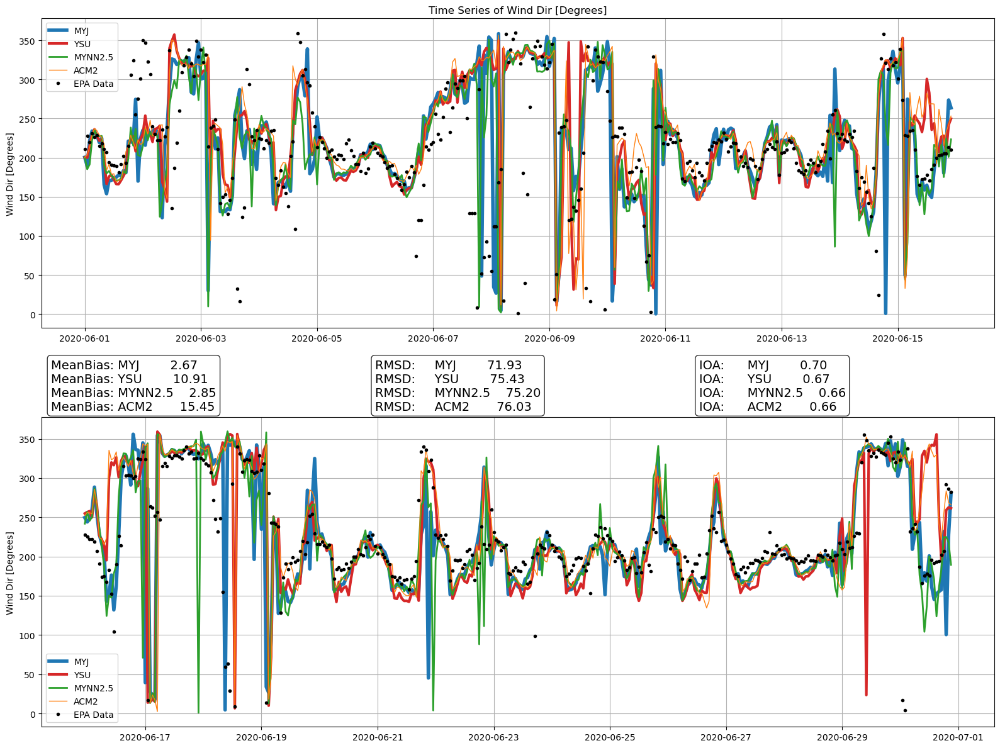

[[2.6703835809629277, 10.909226926920473, 2.847554450164598, 15.445886530251888], [71.92563635190336, 75.42768365192697, 75.19698869547855, 76.03291752539008], [0.6966786588436559, 0.6745333382220462, 0.6559121643264108, 0.6624336235887824]]


In [17]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "wdir10"
Title = "Time Series of Wind Dir [Degrees]"
YLabel = "Wind Dir [Degrees]"
lat_point = 38.56844
lon_point = -121.49311
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_WINDDIR_2020_06_SacSoCap.csv", delimiter=',',usecols=[13],max_rows=718)
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

### Station 12km East of the Capitol in Arden Arcade.
Lat, Long = 38.613779,-121.368014 <br>
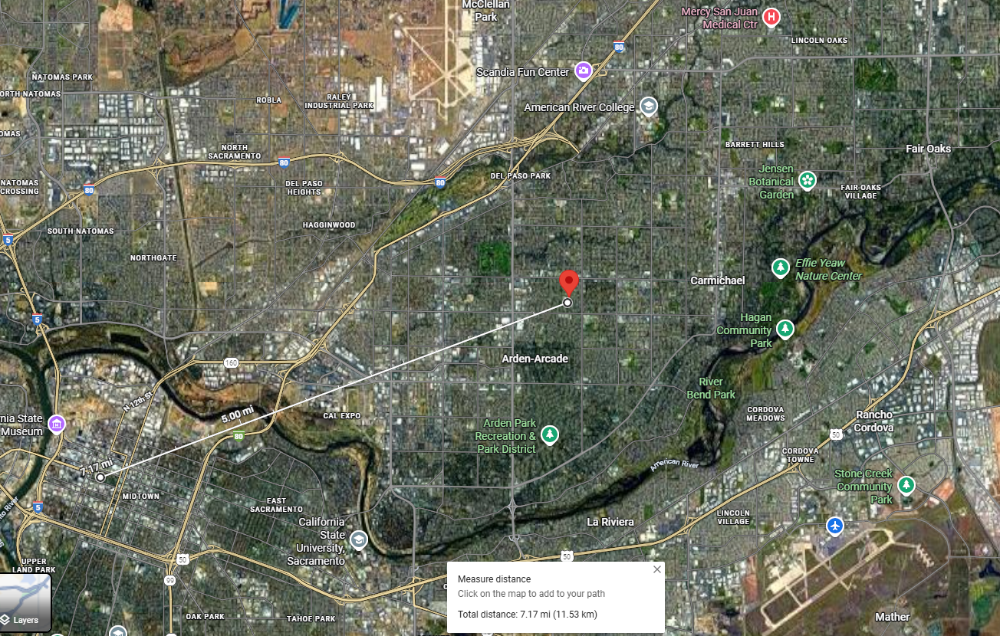

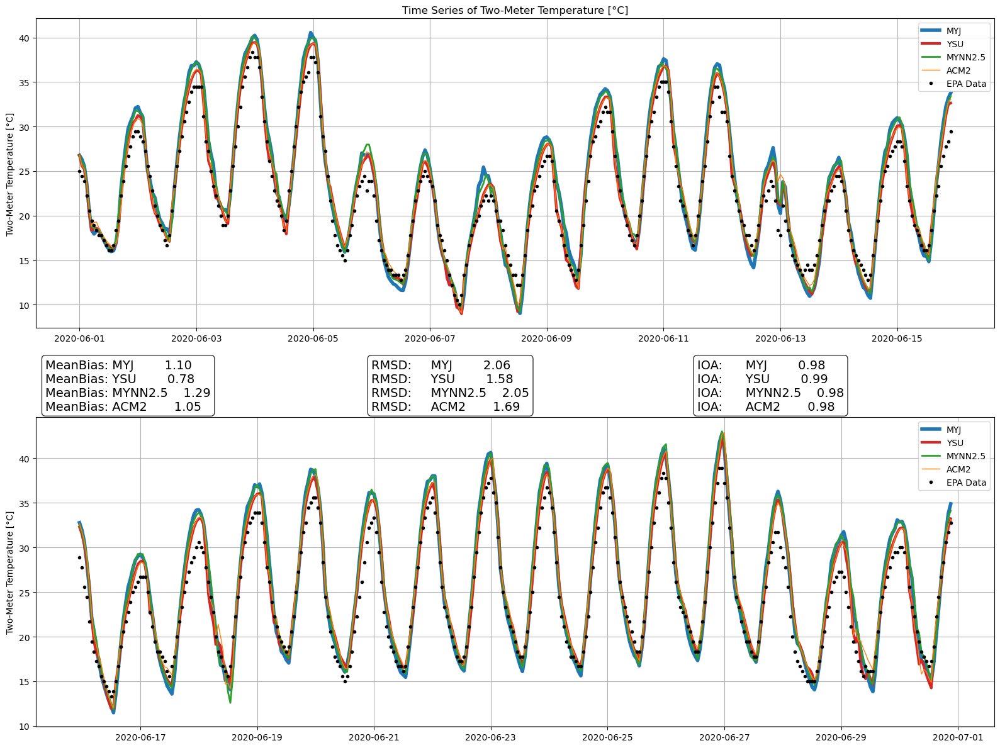

[[1.0960213097136007, 0.7816650503968134, 1.2865171328007352, 1.0536943214296306], [2.0554613053443958, 1.58472928042542, 2.0538081276781592, 1.6928368164752505], [0.9792014672315065, 0.9868419100885417, 0.9788578909533274, 0.9848071600035673]]


In [18]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "T2"
Title = "Time Series of Two-Meter Temperature [°C]"
YLabel = "Two-Meter Temperature [°C]"
lat_point = 38.613779
lon_point = -121.368014
## Load the EPA Data Input File
DataVal = (np.loadtxt("/data/wto/EPAMetData/hourly_TEMP_2020_06_ArdenArcade.csv", delimiter=',',usecols=[13],max_rows=718)-32)*5/9
#print(len(DataVal))

# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point, offset=-273.15)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

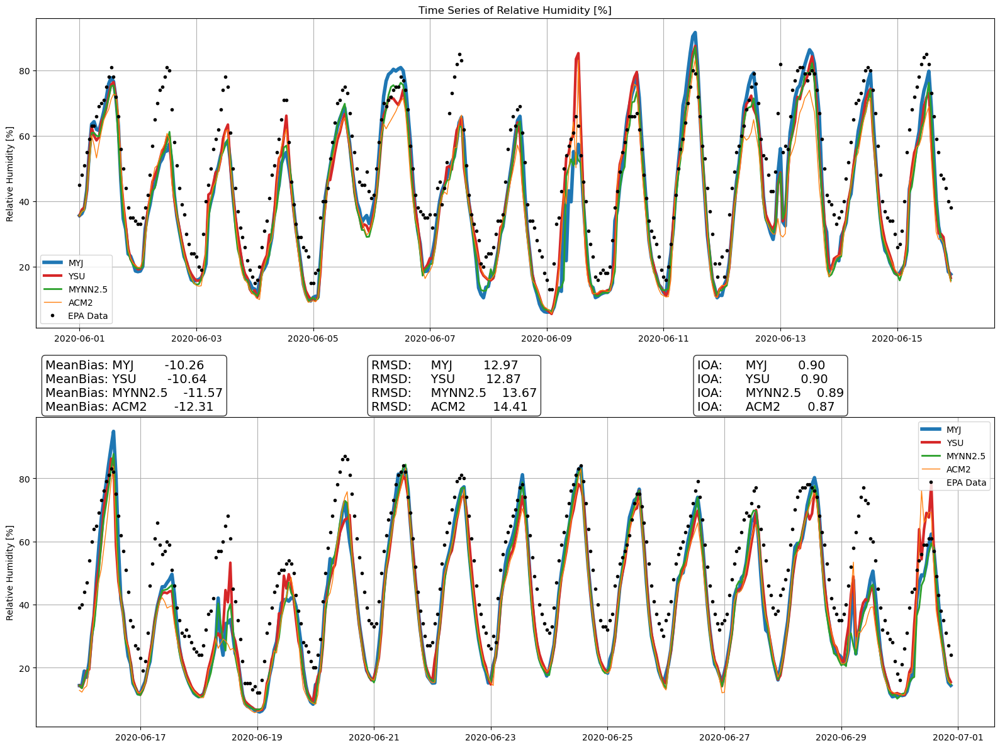

[[-10.258488342954587, -10.636081373459117, -11.56701052288491, -12.312946548700996], [12.971211253843022, 12.86868458155851, 13.668149919315821, 14.412679556335892], [0.9021180092605233, 0.8987036874422492, 0.8893957724575179, 0.8740679791359476]]


In [19]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "rh2"
Title = "Time Series of Relative Humidity [%]"
YLabel = "Relative Humidity [%]"
lat_point = 38.613779
lon_point = -121.368014
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_RH_DP_2020_06_ArdenArcade.csv", delimiter=',',usecols=[13],max_rows=718)
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

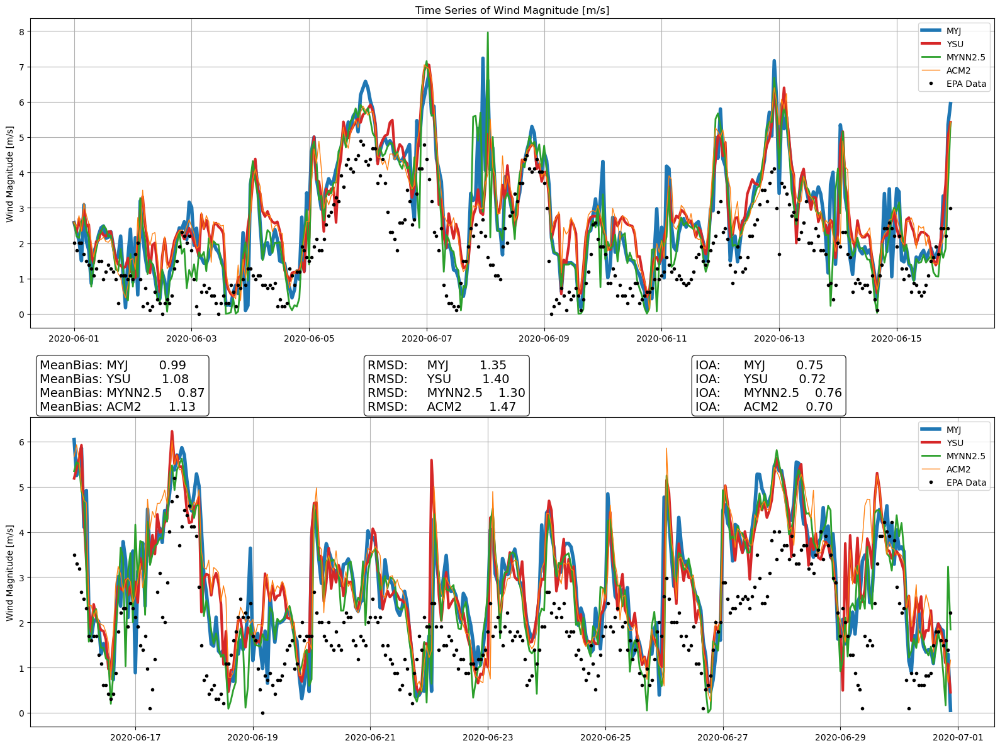

[[0.9931655476843267, 1.077317927019545, 0.8727694815989144, 1.1267322062027674], [1.3486243591956815, 1.3974847093240195, 1.3008002843914939, 1.4669192517490748], [0.7517711073356403, 0.720136208191138, 0.7620507401578654, 0.7013346869035634]]


In [20]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "wspd10"
Title = "Time Series of Wind Magnitude [m/s]"
YLabel = "Wind Magnitude [m/s]"
lat_point = 38.613779
lon_point = -121.368014
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_WINDMAG_2020_06_ArdenArcade.csv", delimiter=',',usecols=[13],max_rows=718)*0.514444
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)

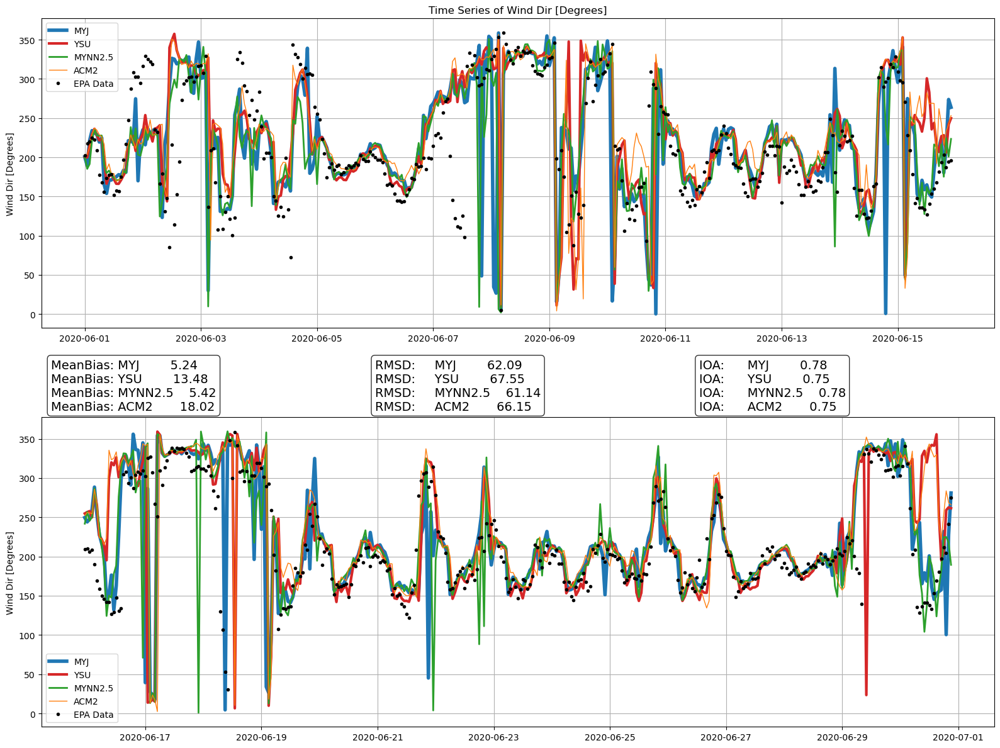

[[5.242110600461534, 13.480953946419081, 5.419281469663204, 18.017613549750497], [62.086285225256916, 67.55393873322757, 61.14446220783501, 66.14618810937992], [0.7798646953558213, 0.7463129566506044, 0.7806739770803769, 0.7521536210156183]]


In [21]:
## Loading the Libaries.
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from wrf import getvar, to_np, get_cartopy, latlon_coords, ll_to_xy, vertcross, interplevel,ALL_TIMES
import cartopy as cp
from glob import glob
from PyWRFFun import MonthTimeSeries, MonthGlob

# === Inputs ===
Var = "wdir10"
Title = "Time Series of Wind Dir [Degrees]"
YLabel = "Wind Dir [Degrees]"
lat_point = 38.56844
lon_point = -121.49311
## Load the EPA Data Input File
DataVal = np.loadtxt("/data/wto/EPAMetData/hourly_WINDDIR_2020_06_ArdenArcade.csv", delimiter=',',usecols=[13],max_rows=718)
# === Get monthly WRF Values ===
WRFFiles = ["/data/wto/WRFOUT/Sac_NDown_UCM1_PBL2_FDDA1_250710/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL1_FDDA1_250714/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL5_FDDA1_250711/wrfout_d01_2020-06-*",
            "/data/wto/WRFOUT/Sac_NDown_UCM1_PBL7_FDDA1_250715/wrfout_d01_2020-06-*"]
Time, Vals = MonthGlob(WRFFiles, Var, lat_point, lon_point)
# Concatenate the Data and WRF Values The [] around DataVal is needed to make sure it adds the array into the list.
Vals = [DataVal] + Vals
# === Call MonthTimeSeries plot function ===
results = MonthTimeSeries(Time,Vals,Title,YLabel, ["EPA Data","MYJ","YSU","MYNN2.5","ACM2"],Show=True)
print(results)